In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.neighbors import KNeighborsClassifier as knn
import warnings

# Ignore warnings
warnings.filterwarnings('ignore')

In [3]:
data = pd.read_csv('/Users/hudajg/Desktop/Cancer.csv')

In [4]:
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [5]:
data.tail()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN
568,92751,B,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,...,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039,NaN


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [7]:
data.isna().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [8]:
data.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [9]:
data['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

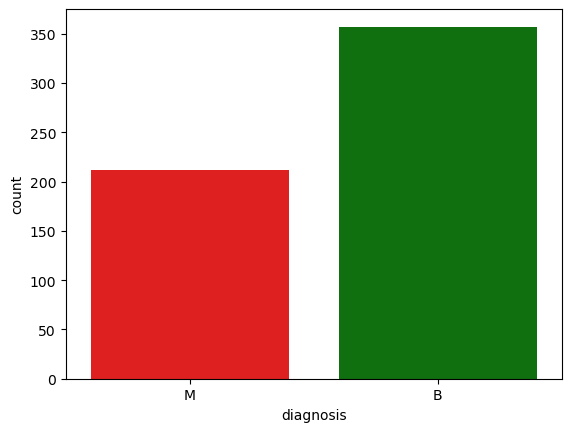

In [10]:
sns.countplot(x='diagnosis', data=data, palette=['red' , 'green'])
plt.show()

In [11]:
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [12]:
data['diagnosis'].replace({"M": "1", "B": "0"}, inplace=True)

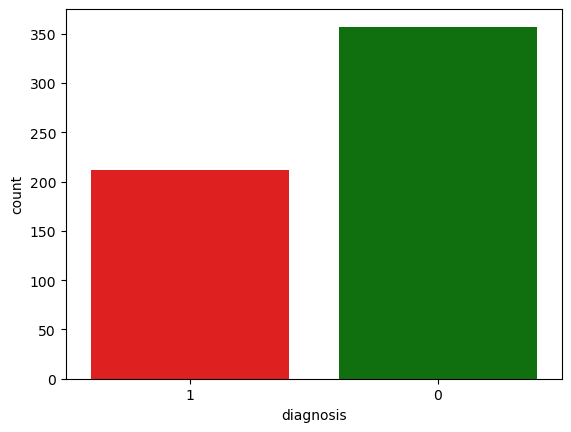

In [13]:
sns.countplot(x='diagnosis', data=data, palette=['red' , 'green'])
plt.show()

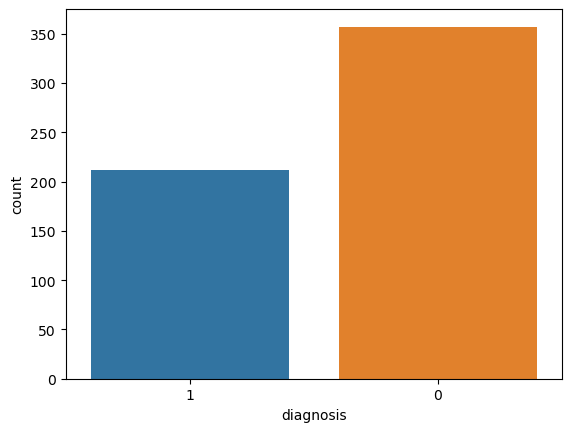

In [14]:
sns.countplot(x='diagnosis', data=data)
plt.show()

In [15]:
data['diagnosis'].value_counts()

diagnosis
0    357
1    212
Name: count, dtype: int64

In [16]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


<Axes: >

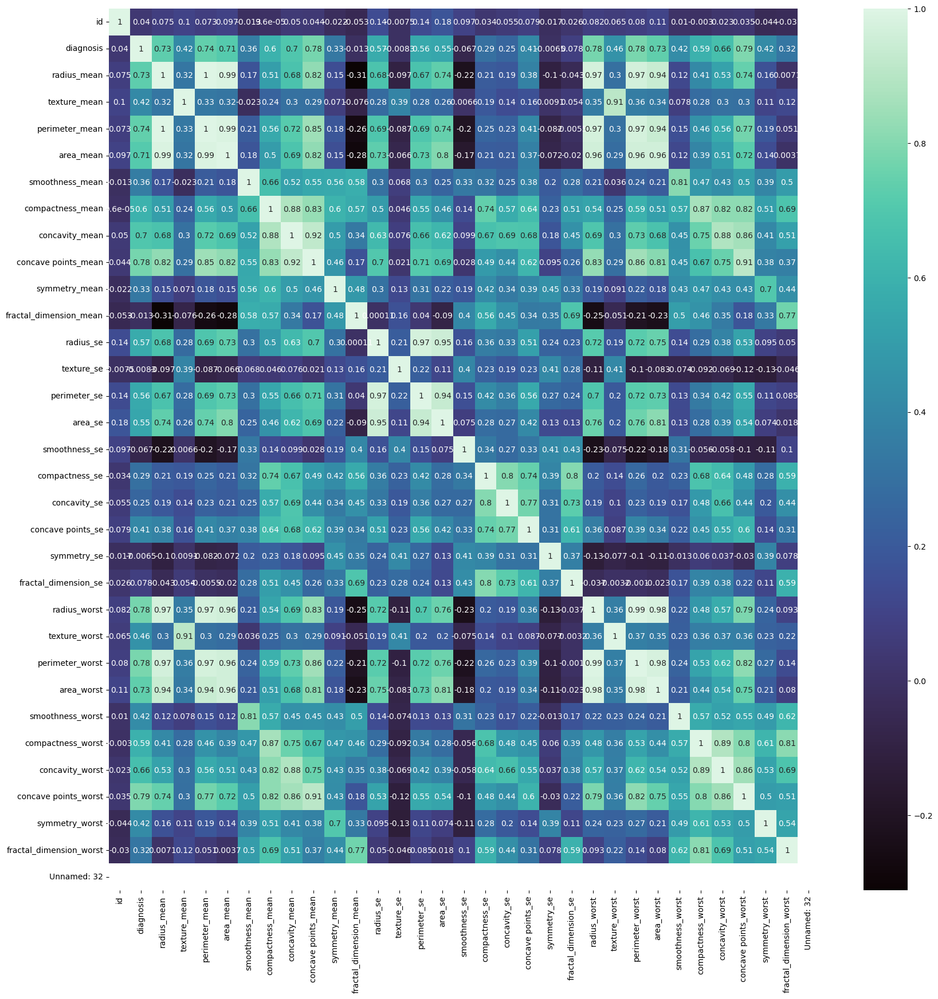

In [17]:
plt.figure(figsize=(20, 20))
sns.heatmap(data.corr(), annot=True, cmap="mako")

In [18]:
sns.pairplot(data , hue = 'diagnosis')

In [ ]:
# Pairplot for numerical columns in the dataset
sns.pairplot(data, diag_kind='kde', markers='o', plot_kws={'alpha':0.5, 's':30})
plt.suptitle('Pairplot for Numerical Features', y=1.02, fontsize=20)
plt.show()


# Step 1: Split the data

In [18]:
x = data.drop(['diagnosis'], axis=1)  # Drop the 'diagnosis' column
y = data['diagnosis']  # Access the 'diagnosis' column

In [19]:
x_train , x_test, y_train , y_test = train_test_split( x,y,test_size =0.30 , random_state =101)

In [22]:
# Initialize the Logistic Regression model
logmodel = LogisticRegression()

# Fit the model to the training data
logmodel.fit(x_train, y_train)

# Predict on the test data
pred = logmodel.predict(x_test)

ValueError: Input X contains NaN.
LogisticRegression does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values

error happen because not put StandardScaler

In [20]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# Step 1: Split the data
x = data.drop(['diagnosis'], axis=1)  # Features
y = data['diagnosis']  # Target

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=101)

# Step 2: Handle missing values using SimpleImputer
imputer = SimpleImputer(strategy='mean')  # You can use 'median' or other strategies
x_train = imputer.fit_transform(x_train)
x_test = imputer.transform(x_test)

# Step 3: Initialize and fit the StandardScaler
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

# Step 4: Initialize the Logistic Regression model
logmodel = LogisticRegression()

# Step 5: Fit the model to the training data
logmodel.fit(x_train, y_train)

# Step 6: Predict on the test data
pred = logmodel.predict(x_test)


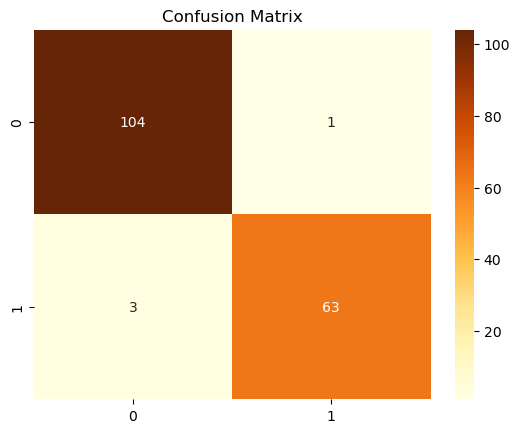

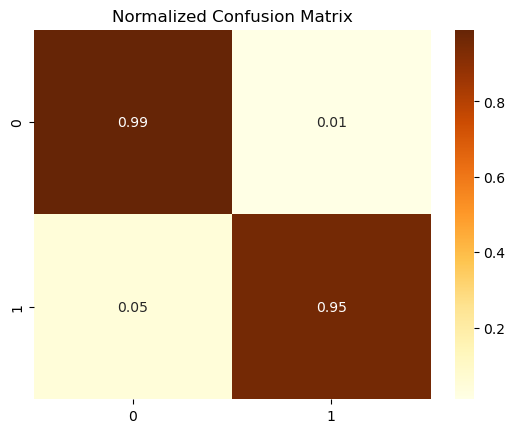

In [21]:
# Compute confusion matrix
cm = confusion_matrix(y_test, logmodel.predict(x_test))

# Plot confusion matrix using seaborn
#plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlOrBr')
plt.title('Confusion Matrix')
plt.show()

plt.title('Normalized Confusion Matrix')
m = confusion_matrix(y_test, logmodel.predict(x_test))

# Normalize the confusion matrix
cm_normalized = cm.astype(float) / cm.sum(axis=1)[:, np.newaxis]
sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='YlOrBr')
plt.show()

In [24]:
print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))
print(accuracy_score(y_test, pred))

[[104   1]
 [  3  63]]
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       105
           1       0.98      0.95      0.97        66

    accuracy                           0.98       171
   macro avg       0.98      0.97      0.98       171
weighted avg       0.98      0.98      0.98       171

0.9766081871345029


In [25]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split


In [26]:
knn_model = KNeighborsClassifier(n_neighbors=5) 
knn_model.fit(x_train, y_train)
knn_pred = knn_model.predict(x_test)

In [29]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, knn_pred)
print(f"Accuracy of KNN model: {accuracy:.2f}")

Accuracy of KNN model: 0.95


In [35]:
knn_model = KNeighborsClassifier(n_neighbors=5)  

In [36]:
# Step 5: Fit the model to the training data
knn_model.fit(x_train, y_train)

# Step 6: Predict on the test data
knn_pred = knn_model.predict(x_test)

In [37]:
# Step 7: Print the confusion matrix, classification report, and accuracy score
print("Confusion Matrix:")
print(confusion_matrix(y_test, knn_pred))

print("\nClassification Report:")
print(classification_report(y_test, knn_pred))

print("\nAccuracy Score:")
print(accuracy_score(y_test, knn_pred))

Confusion Matrix:
[[103   2]
 [  6  60]]

Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       105
           1       0.97      0.91      0.94        66

    accuracy                           0.95       171
   macro avg       0.96      0.95      0.95       171
weighted avg       0.95      0.95      0.95       171


Accuracy Score:
0.9532163742690059


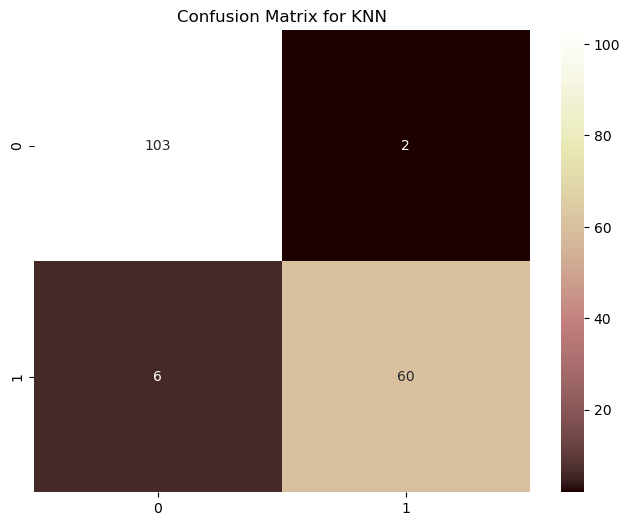

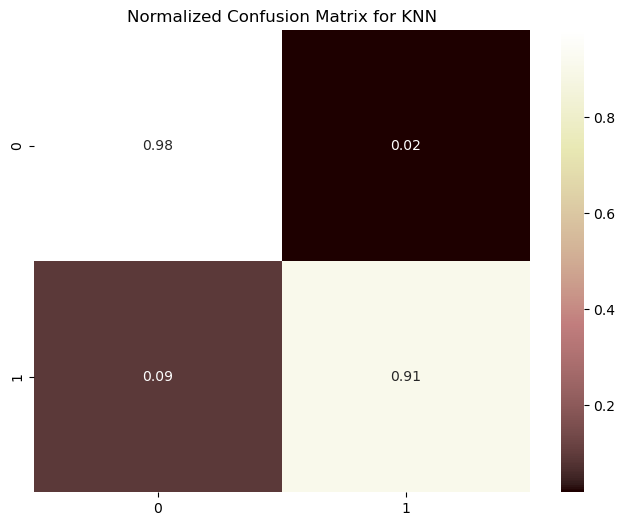

In [38]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Compute confusion matrix for KNN
cm_knn = confusion_matrix(y_test, knn_model.predict(x_test))

# Plot confusion matrix using seaborn with pink color palette
plt.figure(figsize=(8, 6))
sns.heatmap(cm_knn, annot=True, fmt='d', cmap='pink')
plt.title('Confusion Matrix for KNN')
plt.show()

# Normalize the confusion matrix
cm_normalized_knn = cm_knn.astype(float) / cm_knn.sum(axis=1)[:, np.newaxis]

# Plot normalized confusion matrix using pink color palette
plt.figure(figsize=(8, 6))
sns.heatmap(cm_normalized_knn, annot=True, fmt='.2f', cmap='pink')
plt.title('Normalized Confusion Matrix for KNN')
plt.show()


In [40]:

print("\nClassification Report:")
print(classification_report(y_test, knn_pred))

print("\nAccuracy Score:")
print(accuracy_score(y_test, knn_pred))


Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       105
           1       0.97      0.91      0.94        66

    accuracy                           0.95       171
   macro avg       0.96      0.95      0.95       171
weighted avg       0.95      0.95      0.95       171


Accuracy Score:
0.9532163742690059
